# Infer Posterior Distribution of Population Parameters across Lung Cancer Groups

Data:

1. Low erlotinib dose group
2. Medium erlotinib dose group
3. Hogh erlotinib dose group

In [ ]:
import os

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pints
import xarray as xr

import erlotinib as erlo

## Show data

In [2]:
# Get data
data_l = erlo.DataLibrary().lung_cancer_low_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data_l, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data_l, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

In [3]:
# Get data
data_m = erlo.DataLibrary().lung_cancer_medium_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data_m, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data_m, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

In [4]:
# Get data
data_h = erlo.DataLibrary().lung_cancer_high_erlotinib_dose_group()

# Create scatter plots of data
fig = erlo.plots.PKTimeSeriesPlot()
fig.add_data(data_h, biomarker='Plasma concentration')
fig.set_axis_labels(
    time_label=r'$\text{Time in day}$', 
    dose_label=r'$\text{Dose amount in mg}$',
    biom_label=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDTimeSeriesPlot()
fig.add_data(data_h, biomarker='Tumour volume')
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

## Build model

In [5]:
# Define mechanistic model
path = erlo.ModelLibrary().erlotinib_tumour_growth_inhibition_model()
mechanistic_model = erlo.PharmacokineticModel(path)
mechanistic_model.set_administration(compartment='central', direct=False)
mechanistic_model.set_parameter_names(names={
    'central.drug_amount': 'Initial plasma drug amount in mg',
    'dose.drug_amount': 'Initial dose comp. drug amount in mg',
    'central.size': 'Volume of distribution in L',
    'dose.absorption_rate': 'Absorption rate in 1/d',
    'myokit.elimination_rate': 'Elimination rate in 1/d',
    'myokit.tumour_volume': 'Initial tumour volume in cm^3',
    'myokit.critical_volume': 'Critical volume in cm^3',
    'myokit.kappa': 'Potency in L/mg/day',
    'myokit.lambda': 'Exponential growth rate in 1/day'})
mechanistic_model.set_outputs([
    'central.drug_concentration',
    'myokit.tumour_volume'])
mechanistic_model.set_output_names({
    'central.drug_concentration': 'Plasma conc. in ng/mL',
    'myokit.tumour_volume': 'Tumour volume in cm^3'})

# Define error model
error_models = [
    erlo.ConstantAndMultiplicativeGaussianErrorModel(),  # Plasma conc.
    erlo.ConstantAndMultiplicativeGaussianErrorModel()]  # Tumour volume

# Define population model
population_models = [
    erlo.LogNormalModel(),  # Initial tumour volume
    erlo.PooledModel(),     # Volume of distribution
    erlo.LogNormalModel(),  # Critical volume
    erlo.PooledModel(),     # Elimination rate
    erlo.LogNormalModel(),  # Potency
    erlo.LogNormalModel(),  # Growth rate
    erlo.PooledModel(),     # Plasma conc. Sigma rel.
    erlo.PooledModel()]     # Tumour volume Sigma rel.

# Compose model and not identified parameters
problem = erlo.ProblemModellingController(mechanistic_model, error_models)
problem.fix_parameters({
    'Initial plasma drug amount in mg': 0,
    'Initial dose comp. drug amount in mg': 0,
    'Absorption rate in 1/d': 55,  # Data not rich enough (value from Eigenmann et. al.)
    'Plasma conc. in ng/mL Sigma base': 0.001,  # Regularises MultiplicativeError
    'Tumour volume in cm^3 Sigma base': 0.001}) # Regularises MultiplicativeError
problem.set_population_model(population_models)

## Prior Predictive Check

In [31]:
# Define prior distribution
log_priors = [
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Mean Initial tumour volume
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Initial tumour volume
    pints.TruncatedGaussianLogPrior(mean=0.2, sd=0.2, a=0, b=np.inf),    # Volume of distribution
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Mean Critical tumour volume
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Critical tumour volume
    pints.TruncatedGaussianLogPrior(mean=10, sd=5, a=0, b=np.inf),       # Pooled Elimination rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.001, a=0, b=np.inf),      # Mean Potency
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Potency
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=1, a=0, b=np.inf),      # Mean Growth rate
    pints.TruncatedGaussianLogPrior(mean=1, sd=1, a=0, b=np.inf),        # Std. Growth rate
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf),    # Pooled Plasma conc. Sigma rel.
    pints.TruncatedGaussianLogPrior(mean=0.1, sd=0.1, a=0, b=np.inf)]    # Pooled Tumour volume Sigma rel.
log_prior = pints.ComposedLogPrior(*log_priors)

# Compose prior predictive model
predictive_model = problem.get_predictive_model()
prior_predictive_model = erlo.PriorPredictiveModel(
    predictive_model, log_prior)
prior_predictive_model.set_dosing_regimen(dose=0.7, start=3, period=1, num=14)

# Sample from prior predictive model
times = np.linspace(0, 30, num=200)
n_samples = 100
samples = prior_predictive_model.sample(times, n_samples)

# Illustrate prior predictive model
fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, biomarker='Plasma conc. in ng/mL', bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Plasma conc. in ng/mL}$')
fig.show()

fig = erlo.plots.PDPredictivePlot()
fig.add_prediction(data=samples, biomarker='Tumour volume in cm^3', bulk_probs=[0.3, 0.6, 0.9])
fig.set_axis_labels(xlabel=r'$\text{Time in day}$', ylabel=r'$\text{Tumour volume in cm}^3$')
fig.show()

## Find posterior probability distribution

In [32]:
# # Create log-posteriors
# data = pd.concat((data_l, data_m, data_h))
# problem.set_data(data, 
#     output_biomarker_dict={
#         'Plasma conc. in ng/mL': 'Plasma concentration',
#         'Tumour volume in cm^3': 'Tumour volume'})
# problem.set_log_prior(log_priors)
# log_posterior = problem.get_log_posterior()

# Set up sampling controller
np.random.seed(7)
sampler = erlo.SamplingController(log_posterior)
sampler.set_sampler(pints.HamiltonianMCMC)
sampler.set_transform(transform=pints.LogTransformation(n_parameters=problem.get_n_parameters()))
sampler.set_n_runs(5)

# Run sampling
n_iterations = 100
hyperparameters = [5, 0.1]
posterior_samples = sampler.run(
    n_iterations=n_iterations, hyperparameters=hyperparameters, show_progress_bar=True,
    log_to_screen=True)

Using Hamiltonian Monte Carlo
Generating 5 chains.
Running in parallel with 5 worker processess.
Iter. Eval. Accept.   Accept.   Accept.   Accept.   Accept.   Time m:s
0     5      0         0         0         0         0          0:30.8



Exception: Exception in subprocess:
Traceback (most recent call last):
  File "/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py", line 654, in _run
    t = self._sim.sim_step()
ArithmeticError: Function CVode() failed with flag -3 CV_ERR_FAILURE: Error test failures occurred too many times during one internal time step or minimum step size was reached.

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/pints/_evaluation.py", line 462, in run
    f = self._function(x, *self._args)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/pints/_transformation.py", line 1076, in evaluateS1
    logpdf_nojac, dlogpdf_nojac = self._log_pdf.evaluateS1(p)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/erlotinib/_log_pdfs.py", line 788, in evaluateS1
    parameters)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/erlotinib/_log_pdfs.py", line 487, in evaluateS1
    score, sens = log_likelihood.evaluateS1(parameters[indices])
  File "/Users/david/Documents/SABS/DPhil/erlotinib/erlotinib/_log_pdfs.py", line 1212, in evaluateS1
    times=self._times)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/erlotinib/_mechanistic_models.py", line 1124, in simulate
    return self._mechanistic_model.simulate(parameters, times)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/erlotinib/_mechanistic_models.py", line 409, in simulate
    times[-1] + 1, log=self._output_names, log_times=times)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py", line 490, in run
    apd_variable, apd_threshold, progress, msg)
  File "/Users/david/Documents/SABS/DPhil/erlotinib/venv/lib/python3.7/site-packages/myokit/_sim/cvodessim.py", line 683, in _run
    raise myokit.SimulationError('\n'.join(txt))
myokit._err.SimulationError: A numerical error occurred during simulation at t = 3.000000000007381.
Last reached state: 
  myokit.tumour_volume =  3.56645618900511875e-10
  central.drug_amount  =  3.02995082528722953e-02
  dose.drug_amount     =  1.00950491747130361e-01
Inputs for binding:
  time        = 3.01
  pace        = 0.0
  realtime    = 0.0
  evaluations = 6307.0
Function CVode() failed with flag -3 CV_ERR_FAILURE: Error test failures occurred too many times during one internal time step or minimum step size was reached.

Exception in subprocess

## Find hyperparameters for good convergence

### Pooled

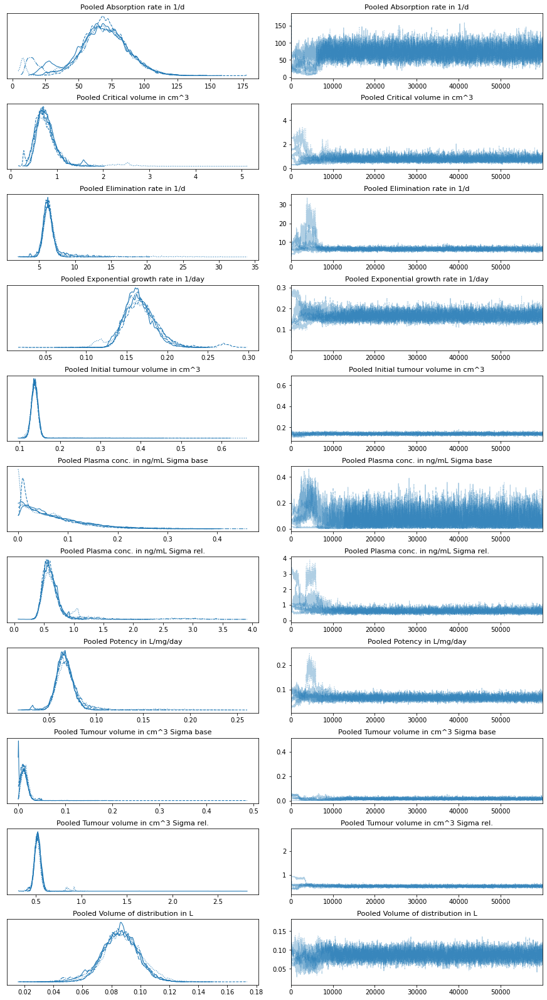

In [11]:
import arviz as az
import matplotlib.pyplot as plt

az.plot_trace(posterior_samples)
plt.show()

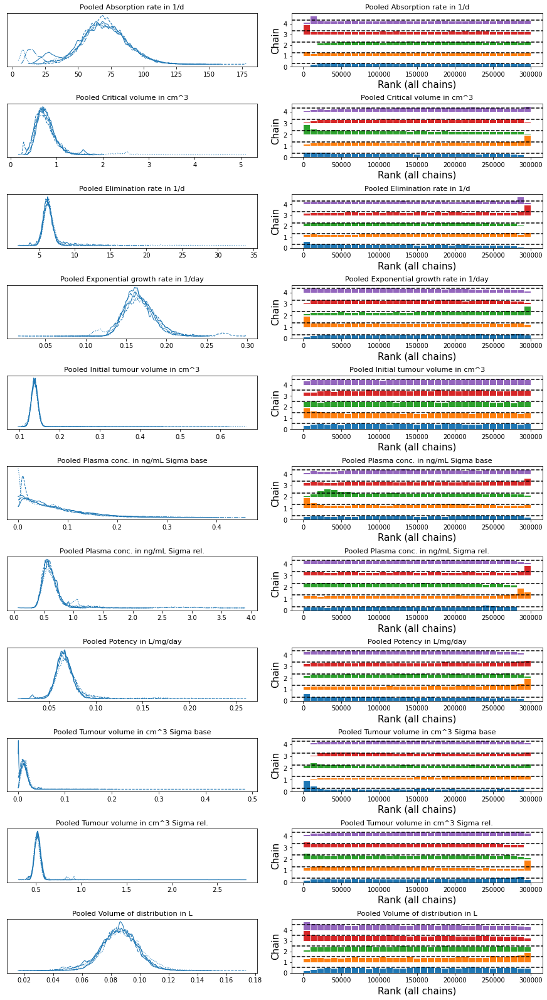

In [12]:
az.plot_trace(posterior_samples, kind='rank_bars')
plt.show()

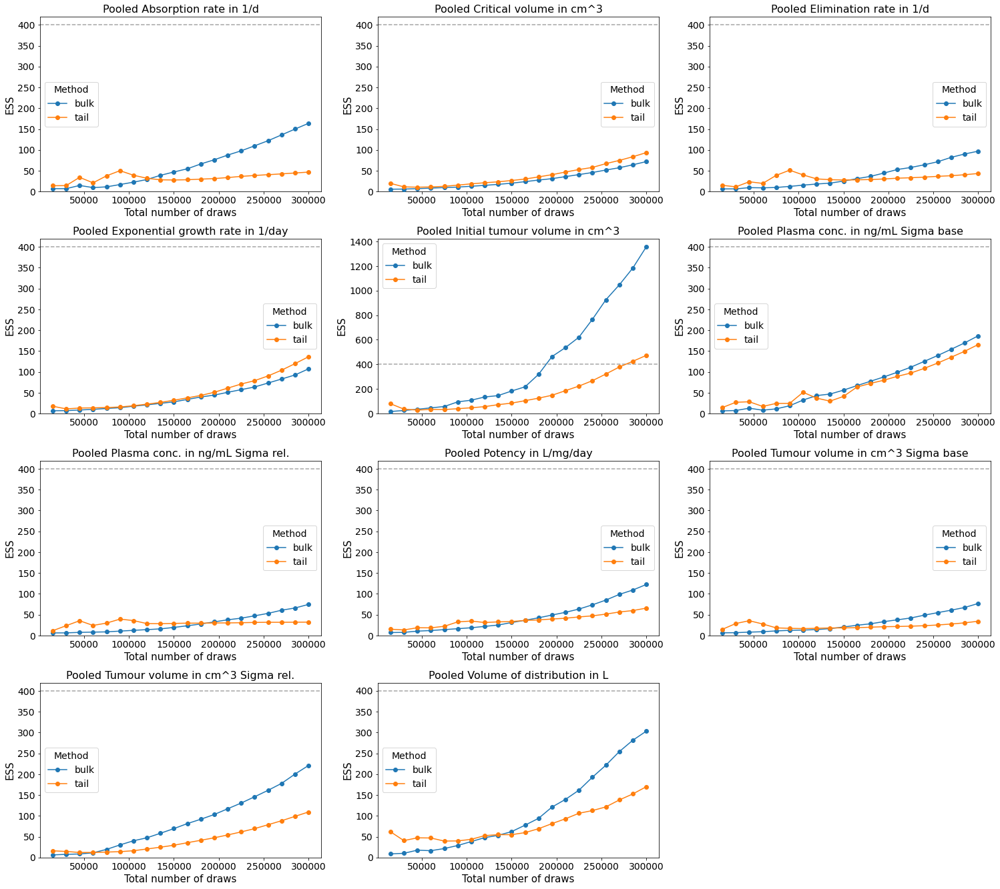

In [13]:
az.plot_ess(posterior_samples, kind="evolution")
plt.show()

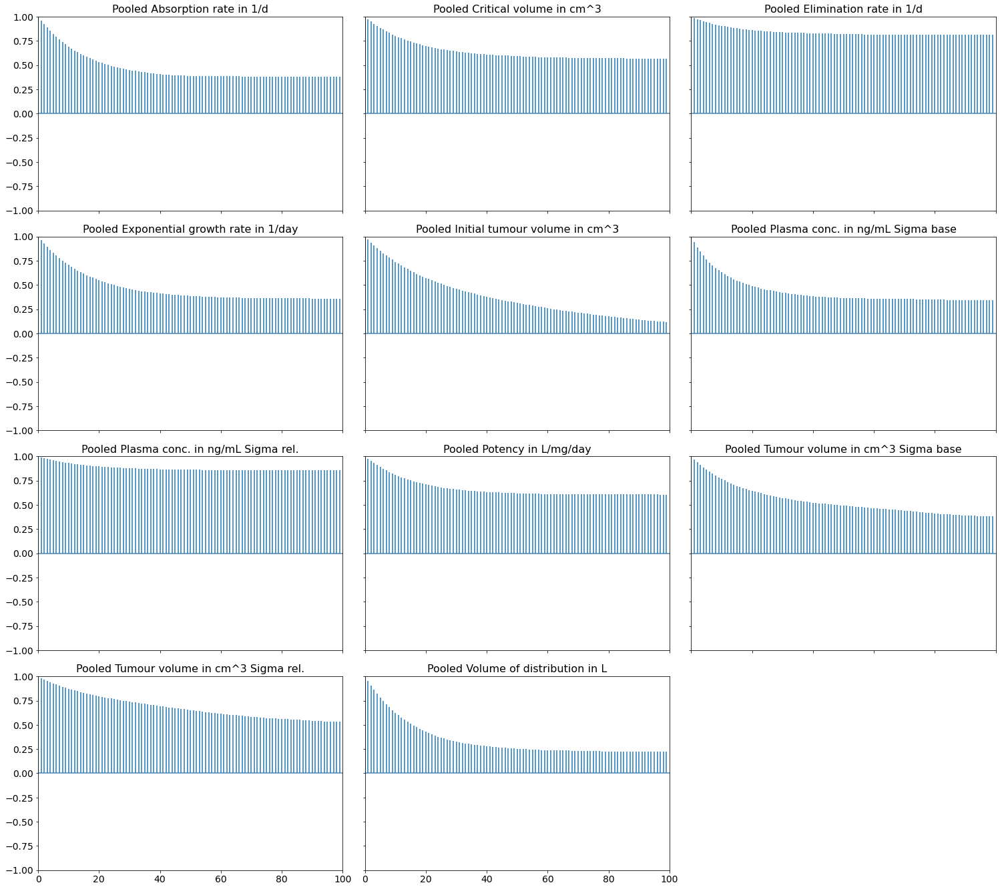

In [14]:
az.plot_autocorr(posterior_samples, combined=True)
plt.show()

### Exclude warmup

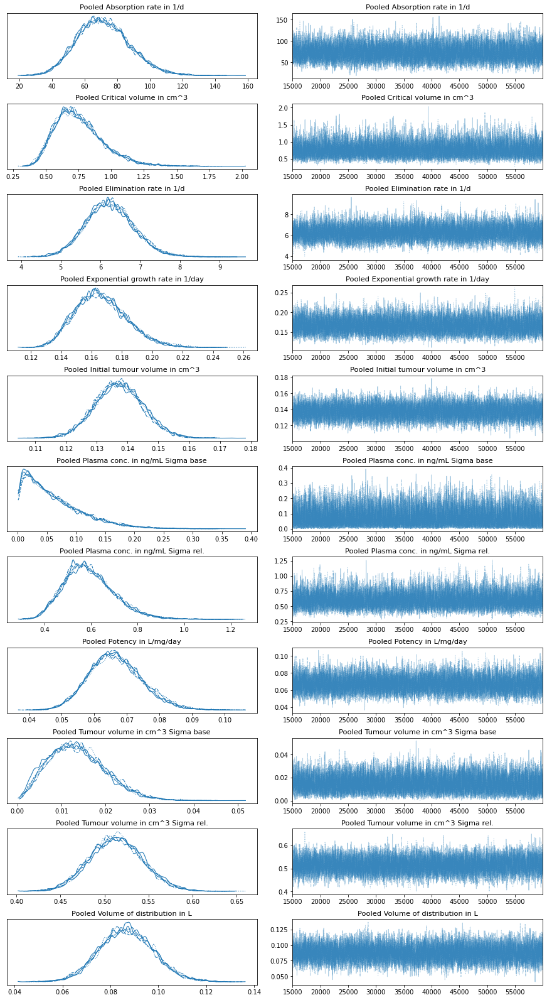

In [15]:
warmup = 15000

az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations)))
plt.show()

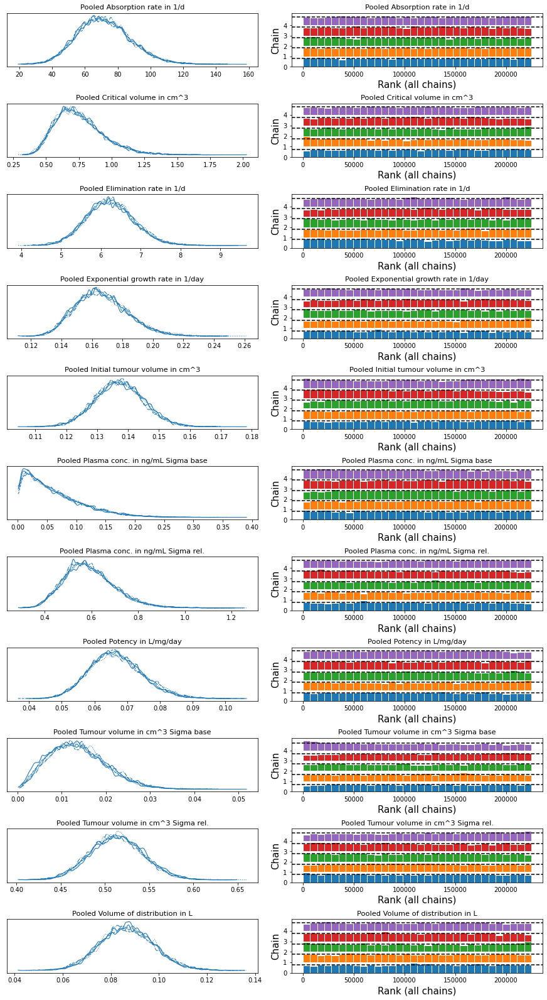

In [16]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations)), kind='rank_bars')
plt.show()

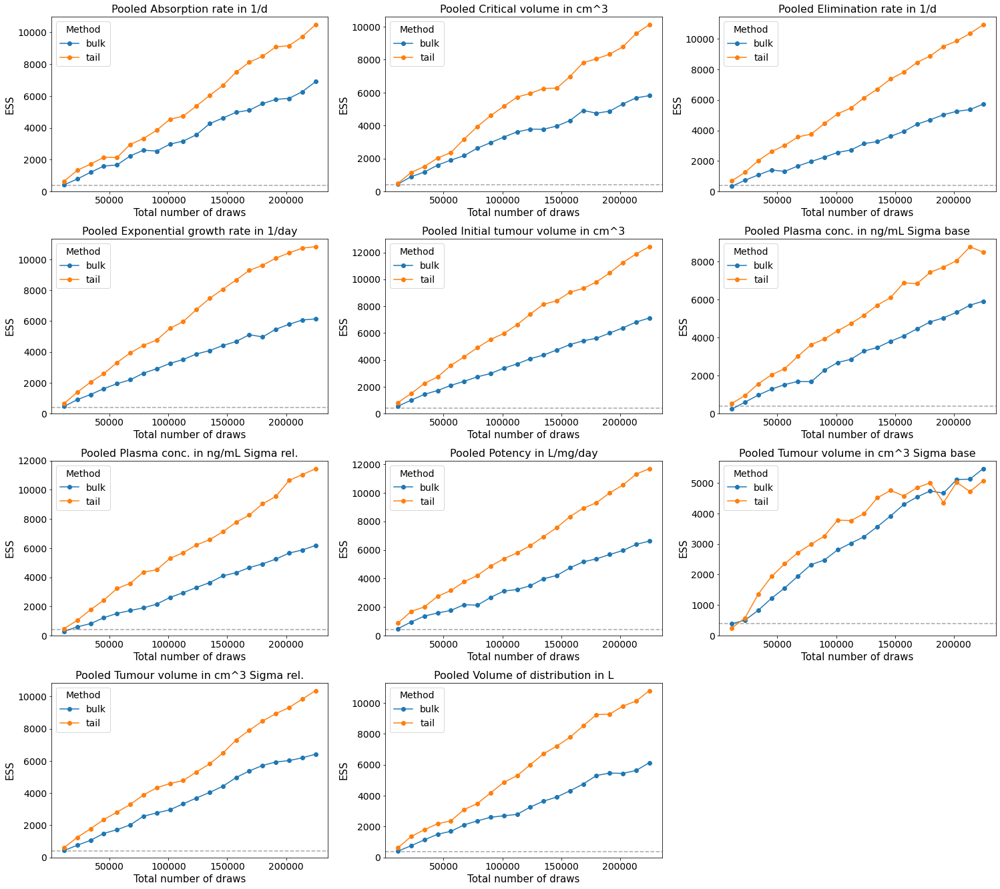

In [17]:
az.plot_ess(posterior_samples.sel(draw=slice(warmup, n_iterations)), kind="evolution")
plt.show()

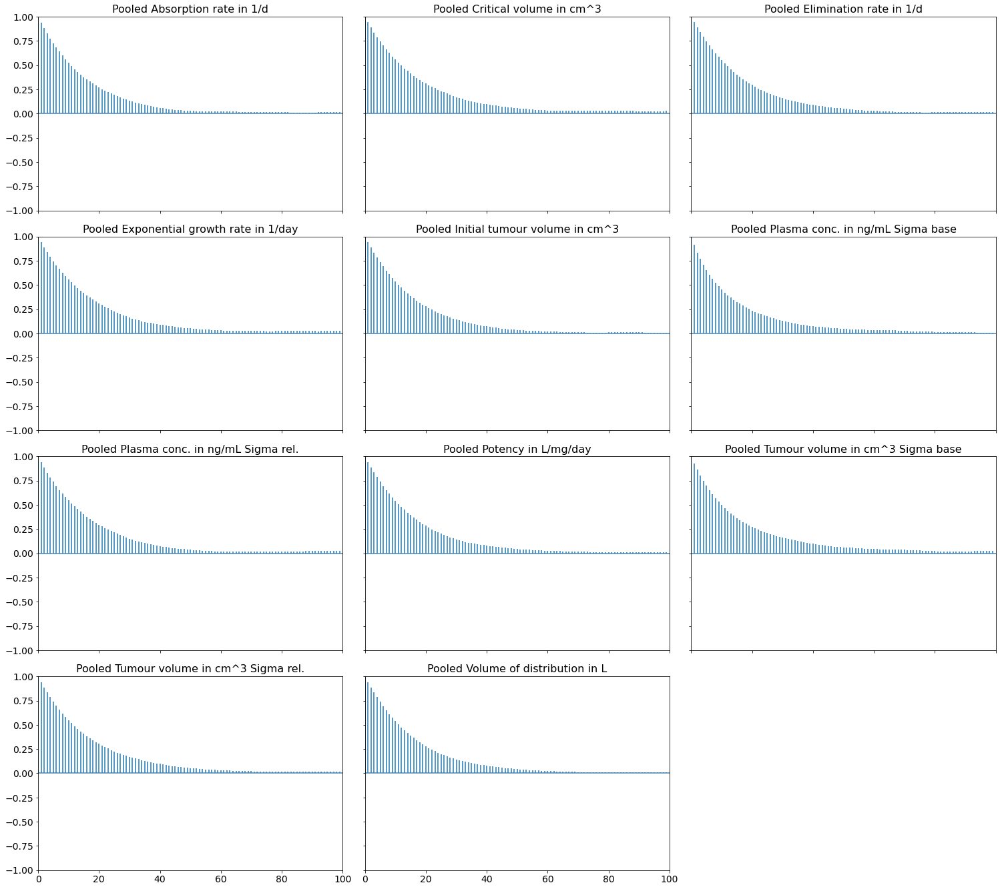

In [18]:
az.plot_autocorr(posterior_samples.sel(draw=slice(warmup, n_iterations)), combined=True)
plt.show()

### Reduce correlations by thinning out

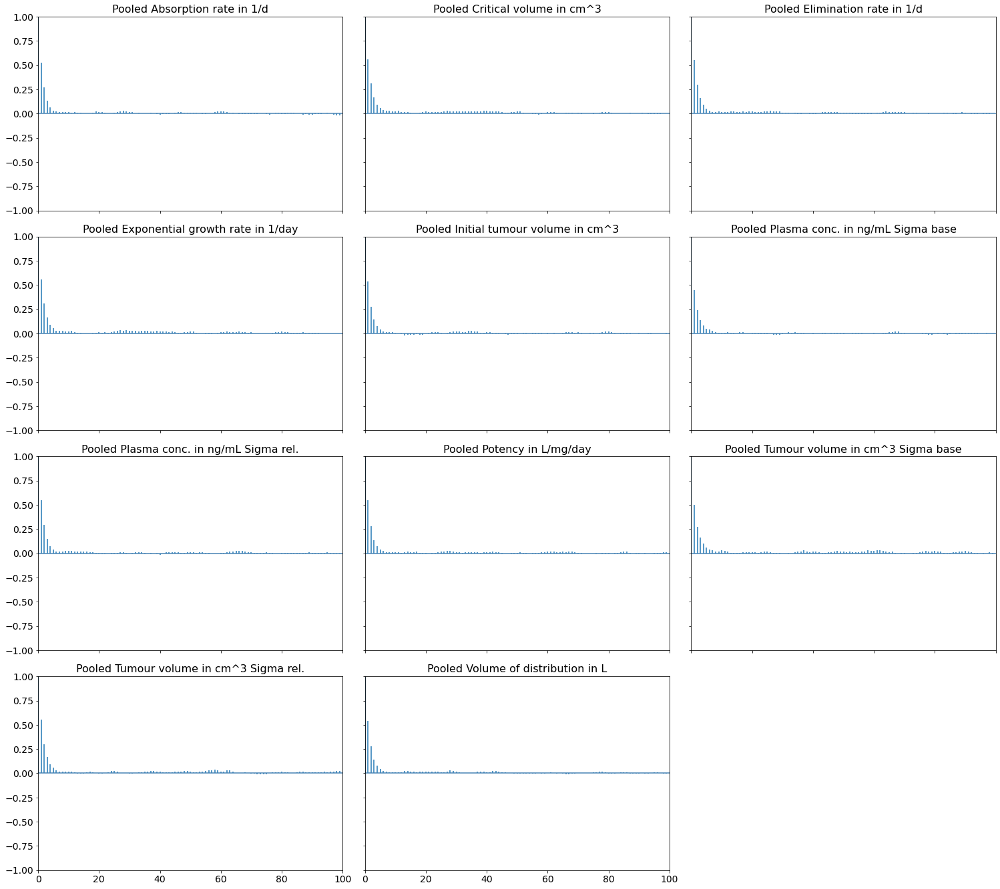

In [19]:
thinning_ratio = 10

az.plot_autocorr(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), combined=True)
plt.show()

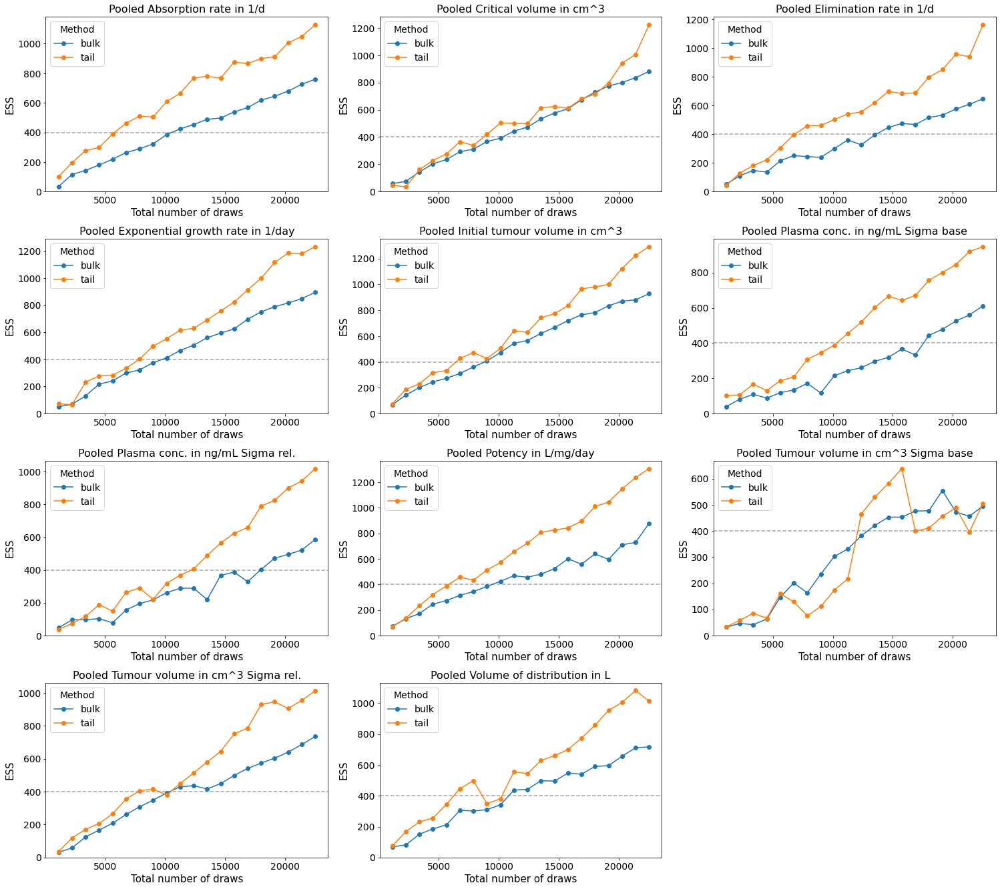

In [20]:
az.plot_ess(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), kind="evolution")
plt.show()

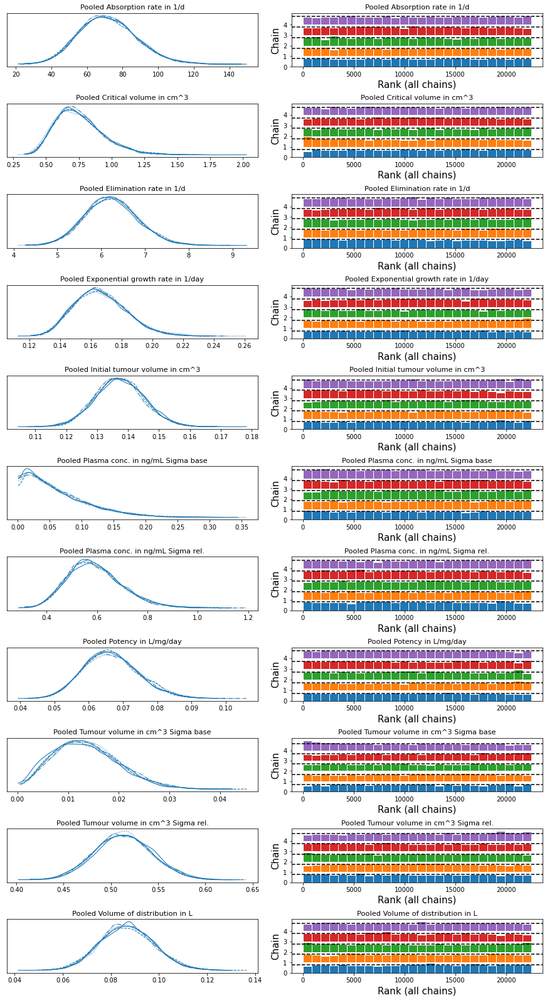

In [21]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)), kind='rank_bars')
plt.show()

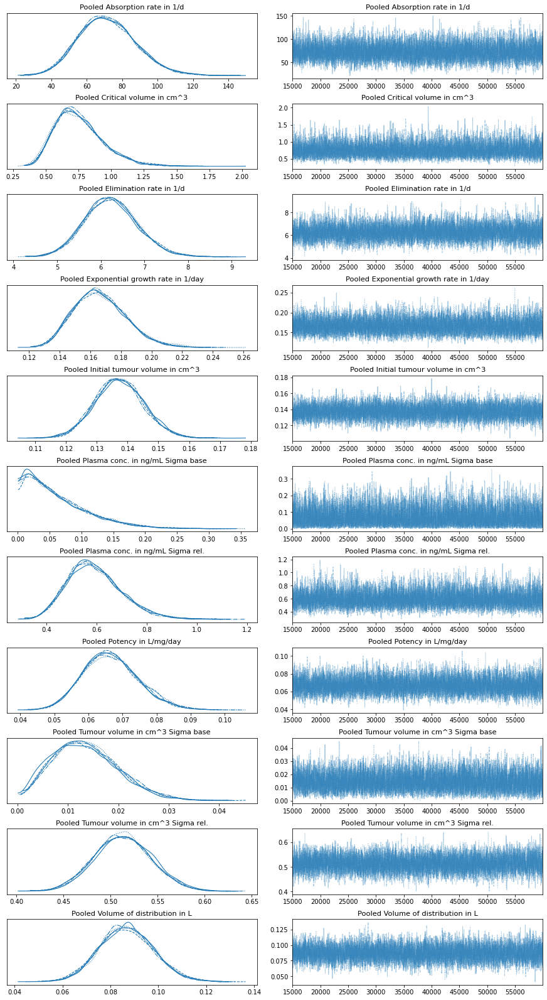

In [22]:
az.plot_trace(posterior_samples.sel(draw=slice(warmup, n_iterations, thinning_ratio)))
plt.show()

## Save posterior

In [23]:
import os

# Rename parameters (for export)
temp = posterior_samples.rename({
    'Pooled Initial tumour volume in cm^3': 'pooled_initial_tumour_volume',
    'Pooled Critical volume in cm^3': 'pooled_critical_volume',
    'Pooled Exponential growth rate in 1/day': 'pooled_growth_rate',
    'Pooled Plasma conc. in ng/mL Sigma base': 'pooled_plasma_concentration_sigma_base',
    'Pooled Plasma conc. in ng/mL Sigma rel.': 'pooled_plasma_concentration_sigma_rel',
    'Pooled Absorption rate in 1/d': 'pooled_absorption_rate',
    'Pooled Volume of distribution in L': 'pooled_volume_distribution',
    'Pooled Elimination rate in 1/d': 'pooled_elimination_rate',
    'Pooled Potency in L/mg/day': 'pooled_potency',
    'Pooled Tumour volume in cm^3 Sigma base': 'pooled_tumour_volume_sigma_base',
    'Pooled Tumour volume in cm^3 Sigma rel.': 'pooled_tumour_volume_sigma_rel'})

# Export samples
directory = os.getcwd()
name = '/posteriors/pooled.nc'
temp.sel(draw=slice(warmup, n_iterations, thinning_ratio)).to_netcdf(directory + name)